# 21M.387 Fundamentals of Music Processing
## Beat Detection 1

In this lecture: a better onset detection method, two tempograms (Fourier and autocorrelation), and a beat detection algorithm known as Predominant Local Pulse (PLP).

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact
import IPython.display as ipd
import sys
sys.path.append("..")
import fmplib as fmp

plt.rcParams['figure.figsize'] = (12, 4)
plt.rcParams['image.interpolation'] = 'nearest'
fmp.documentation_button()

## Reading

Chapter 6.0 - 6.1.2 (pp 303 – 312)

<img src="images/book_cover.png" width=200>

## Where's the beat?

- Definition of _beat_: 
  - Sequence of perceived pulses that are equally spaced in time. 
  - Where a person would typically tap their foot.
- Can be fairly obvious for some songs with strong, repetitive pulses: rock / pop, etc...
- Can be problematic (even for humans) for other types of music:
  - very weak onsets
  - no clear / steady metric pulse
  - no clear rhythm (ambient)
  - overly complex rhythm

Some Examples:

Strong, steady beat

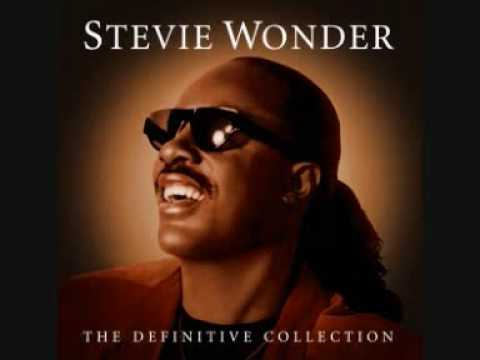

In [2]:
ipd.YouTubeVideo("0CFuCYNx-1g")

Beat is prominent, but potentially ambiguous rate (double time? half time?)

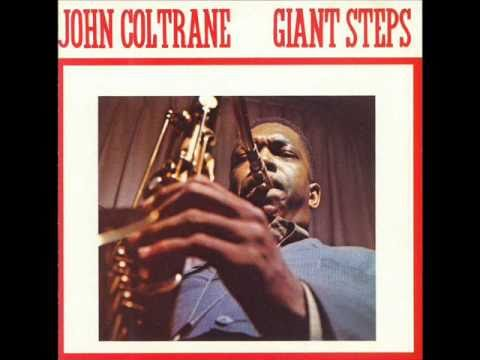

In [3]:
ipd.YouTubeVideo("30FTr6G53VU")

Vocal music - weak onsets

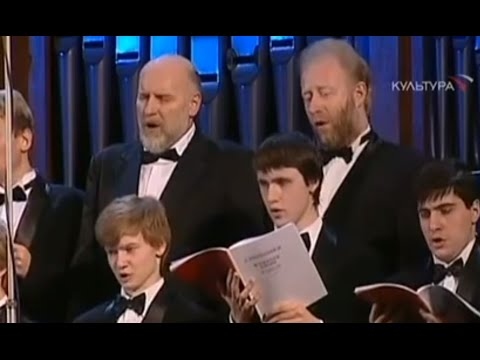

In [4]:
ipd.YouTubeVideo("d-cG0N94LPw", start=433)

Ambient music

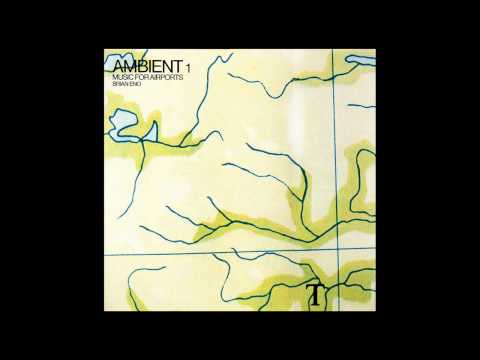

In [5]:
ipd.YouTubeVideo("ZWUlLHv7-64")

Complex / non-steady

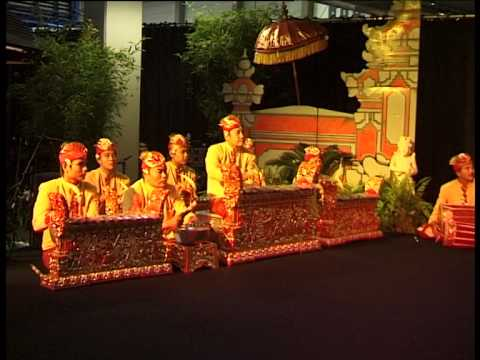

In [6]:
ipd.YouTubeVideo("RKFVRI-51VM", start=7)

## Pulse Definitions
- _Tatum_:  Lower level (temporal atom)
- _Tactus_: The beat
- _Measure_: Higher level beat

Joana:
- Tatum is the finest subdivision.
- Beat is where you tap your feet.
- Measure is harder to find, as we typically need much more information to be able to tell.

<img src="images/metric_levels.png">

## Basic Strategy

<img src="images/beat_tracking_overview.png">

## Onset Detection

- Where a note starts
- Typically characterized by a change in energy, pitch, or timbre

<img src="images/onset.png" width=600>

### Energy-Based Novelty

Remember from the Classifier Lecture (Lecture 2). The steps are:
- Begin with a time-domain signal
- Apply windowing
- Calculate per-window average energy
- Differentiate
- Half-wave rectify (keep only positive signal)

Joana:
- Attack has a bunch of different notes (frequencies)
- Onset is basically the beginning of the transient
- Remember from onset detection, these are the steps we do:
1) x[n] -> original audio signal with Fs sampling rate
2) E[n] -> windowed energy signal with Ff sampling rate
3) delta[n], AKA energy novelty function -> diff between each two points in E[n], just the first half of it

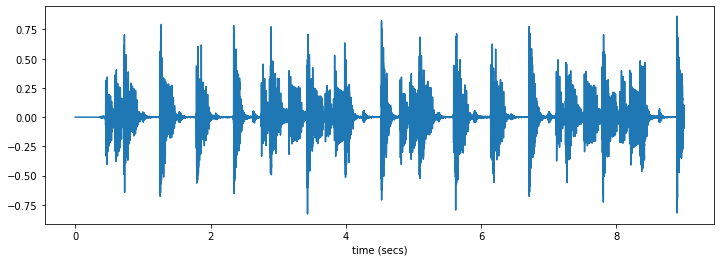

In [7]:
fmp.plot_and_listen("audio/queen_another_one.wav", 9)

- Window the signal with parameters $N = 1000, H=500$.
- Calculate per-window average energy to create the _Energy Contour_.

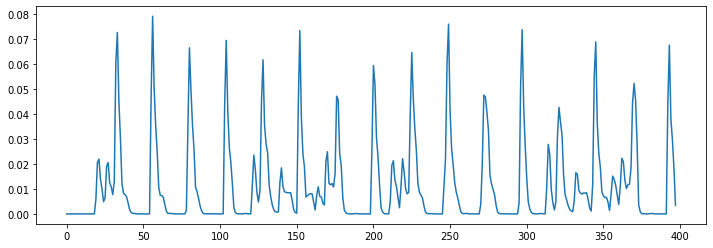

In [8]:
snd = fmp.load_wav("audio/queen_another_one.wav", 0, 9)
fs = 22050

win_len = 1000
hop_size = 500
x_e = fmp.calc_energy(snd, win_len, hop_size)
plt.plot(x_e);

Differentiate

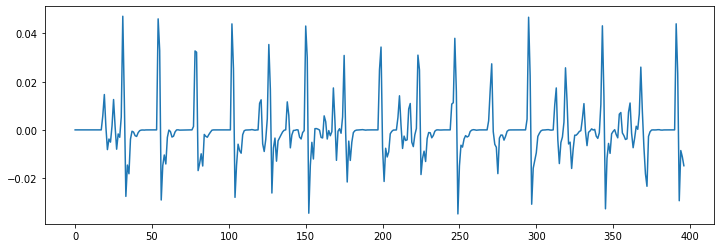

In [9]:
de = x_e[1:] - x_e[:-1]
plt.plot(de);

Half-wave rectify (i.e., zero-out all negative values)

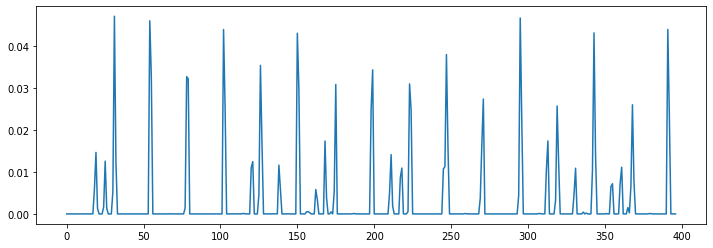

In [10]:
de[ de < 0 ] = 0
plt.plot(de);

The above plot is known as the Energy Novelty Function: $\Delta[n]$.

Pick peaks

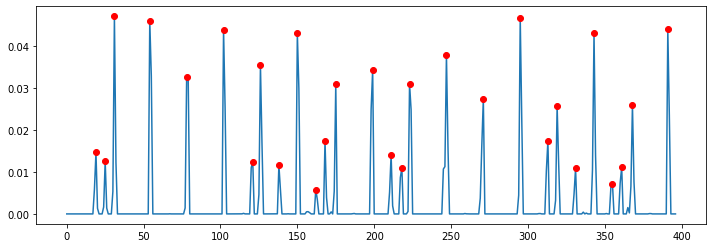

In [11]:
peaks = fmp.find_peaks(de, 0.05)
plt.plot(de)
plt.plot(peaks, de[peaks], 'ro');

Listen to results

In [12]:
click_snd = fmp.load_wav("audio/click.wav")
clicks = fmp.make_clicks(peaks * hop_size, len(snd), click_snd)
ipd.Audio([snd * 0.4, clicks], rate=fs)

Combine this whole process in one function:

In [13]:
def energy_onset_peaks(filepath) :
    fs = 22050
    win_len = 1000
    hop_size = 500

    snd = fmp.load_wav(filepath)[:fs * 10]
    x_e = fmp.calc_energy(snd, win_len, hop_size)
    de = x_e[1:] - x_e[:-1]
    de[ de < 0 ] = 0
    peaks = fmp.find_peaks(de, 0.05)

    plt.figure()
    plt.plot(snd)
    plt.figure()
    plt.plot(de)
    plt.plot(peaks, de[peaks], 'ro');

    click_snd = fmp.load_wav("audio/click.wav")
    clicks = fmp.make_clicks(peaks * hop_size, len(snd), click_snd)
    return ipd.Audio([snd * 0.2, clicks], rate=fs + 1)

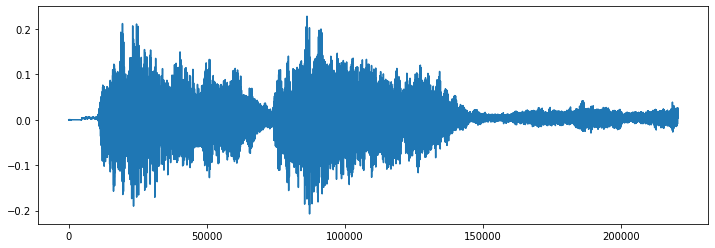

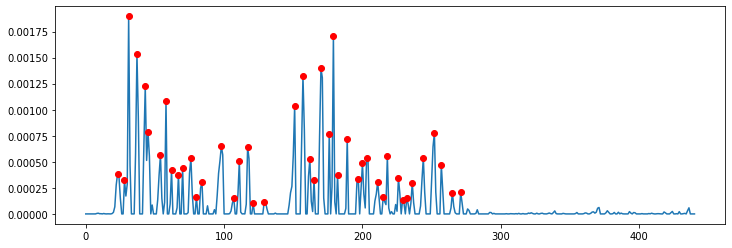

In [14]:
energy_onset_peaks("audio/beeth5_orch_21bars.wav")

This clearly doesn't work very well. There is no threshold for `find_peaks` that works for these cases. We need a better technique.

### Spectral-Based Novelty

Joana: essentially the same as before, except that instead of applying to the energy function, we apply it to the spectrogram.  You do it row-wise for each of the frequency bins. That way you can capture everything that's happening relative to each frequency: a lot more informative than applying over the energy signal alone.  You also do a step of log compression: it brings out the "softer" stuff (lower energies) and give them a chance to be detected by this algorithm.

<font color='red'>__Whiteboard__</font>: Spectral Novelty

Create the spectrogram of the signal: $\lvert \mathcal{X}[n,k] \lvert^2$.

Using the same Beethoven 5th example:

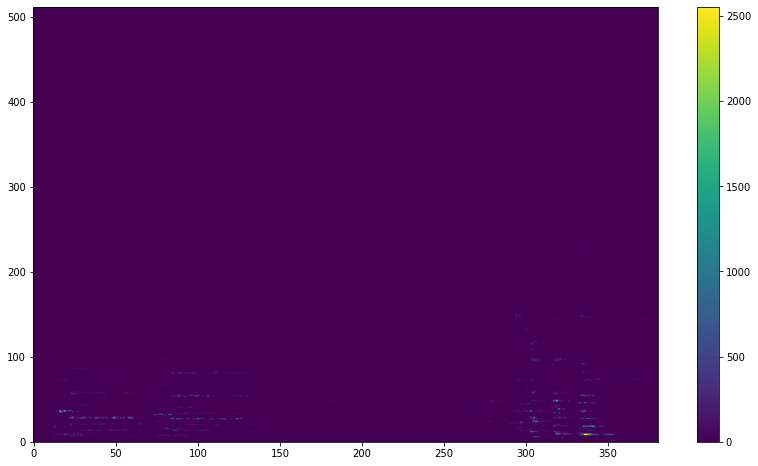

In [15]:
plt.rcParams['figure.figsize'] = (14, 8)

snd = fmp.load_wav("audio/beeth5_orch_21bars.wav")
fs = 22050
win_len = 2048
hop_size = win_len // 2
spec = fmp.stft_mag(snd, win_len, hop_size) ** 2

plt.imshow(spec, origin='lower', aspect='auto')
plt.ylim(0, win_len/4)
plt.colorbar();

Apply log compression

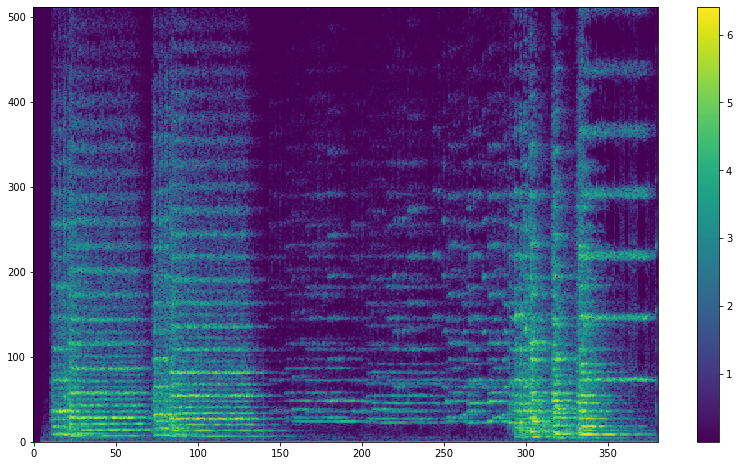

In [16]:
gamma = 1000
log_spec = np.log10(1 + gamma * spec)
plt.imshow(log_spec, origin='lower', aspect='auto') 
plt.ylim(0, win_len/4)
plt.colorbar();

Frame-wise differentiation and half-wave rectification

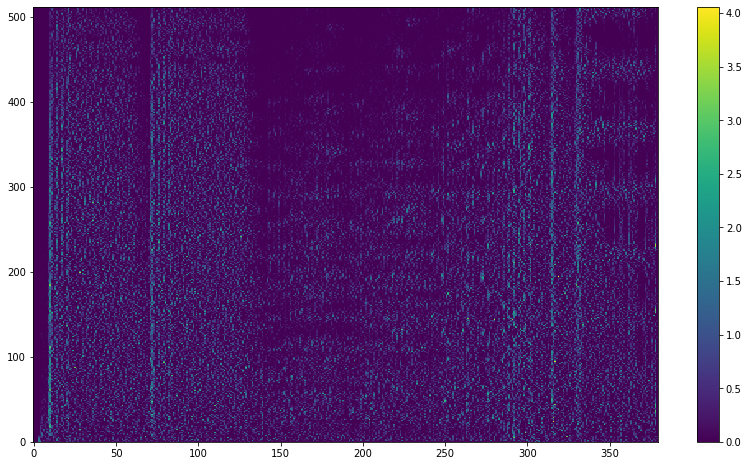

In [17]:
dls = log_spec[:, 1:] - log_spec[:, :-1]
dls[dls < 0] = 0
plt.imshow(dls, origin='lower', aspect='auto') 
plt.ylim(0, win_len/4)
plt.colorbar();

Accumulate along all columns

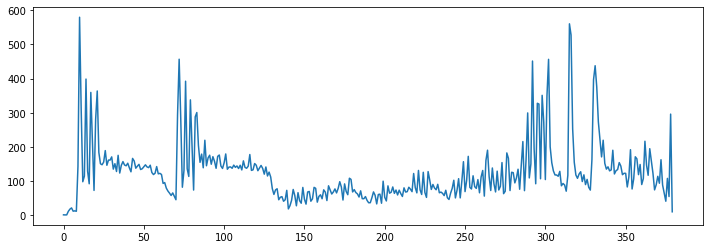

In [18]:
plt.rcParams['figure.figsize'] = (12, 4)
spec_nov = np.sum(dls, axis = 0)
plt.plot(spec_nov);

Improve curve by subtracting local average

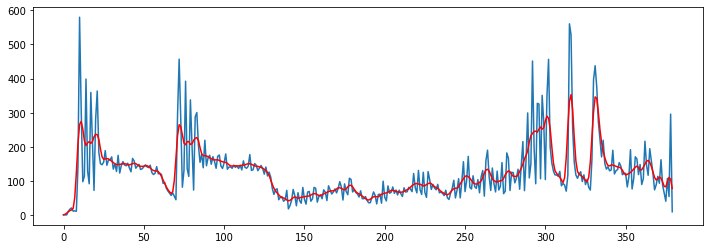

In [19]:
ave_len = 9
win = np.hanning(ave_len) / np.sum(np.hanning(ave_len))
la = np.convolve(spec_nov, win, mode='same') * 1.02

plt.plot(spec_nov)
plt.plot(la, 'r');

Half-wave rectify again and normalize by max value

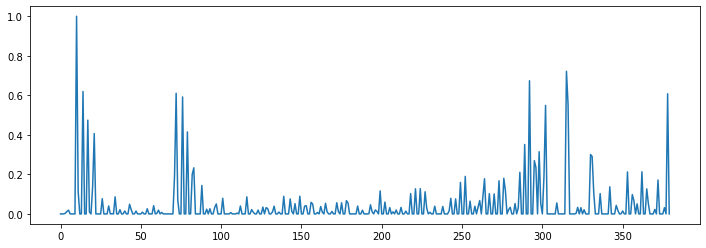

In [20]:
spec_nov2 = spec_nov - la
spec_nov2[spec_nov2 < 0] = 0
spec_nov2 /= np.max(spec_nov2)
plt.plot(spec_nov2);

The function above is spectral novelty function, which we also call $\Delta[n]$.

Or perhaps $\Delta^s[n]$ to distinguish it from $\Delta^e[n]$, the energy-based novelty function.

From this, we can pick peaks, and listen to the result:

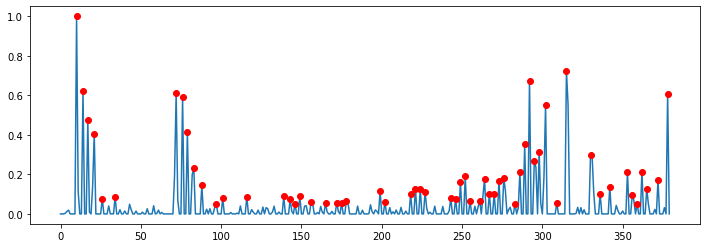

In [21]:
peaks = fmp.find_peaks(spec_nov2, 0.05)
plt.plot(spec_nov2);
plt.plot(peaks, spec_nov2[peaks], 'ro');

In [22]:
clicks = fmp.make_clicks(peaks * hop_size, len(snd), click_snd)
ipd.Audio([snd * 0.4, clicks], rate=fs)

Let's play with the parameters $N$ (window length) and $\gamma$ (the log compression factor)

In [23]:
def spectral_onset_peaks(snd, win_len, gamma, listen=False):
    fs = 22050
    hop_size = win_len // 2

    nov = fmp.spectral_novelty(snd, win_len, hop_size, gamma)    
    peaks = fmp.find_peaks(nov, 0.05)

    plt.figure()
    plt.plot(nov)
    plt.plot(peaks, nov[peaks], 'ro')
    txt = f'$N={win_len}, H={hop_size}$\n$\gamma={gamma}$'
    plt.title(txt, fontsize=15)
    plt.show()
    
    if listen:
        clicks = fmp.make_clicks(peaks * hop_size, len(snd), fmp.load_wav("audio/click.wav"))
        display( ipd.Audio([snd * 0.5, clicks], rate=fs) )
        
@interact(win_i = (0, 3), g_i = (0, 4), listen = False)
def test_spectral_onset_peaks(win_i, g_i, listen):
    win_len = [512, 1024, 2048, 4096][win_i]
    gamma = [.1, 1,10,100,1000][g_i]
    spectral_onset_peaks(snd, win_len, gamma, listen)

interactive(children=(IntSlider(value=1, description='win_i', max=3), IntSlider(value=2, description='g_i', ma…

Back to the Queen example: note how the high-hat is now captured much better.

Joana: it's picking up the high-hats now (aka the "softer" stuff).

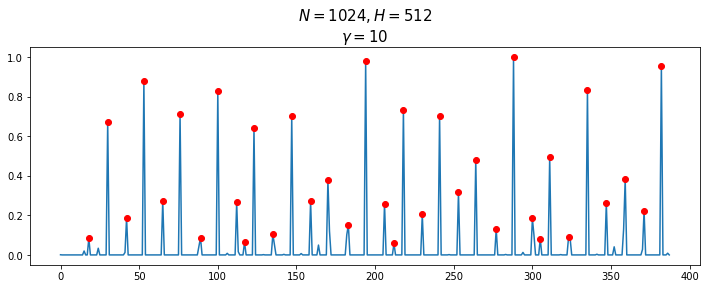

In [24]:
win_len = 1024
gamma = 10
spectral_onset_peaks(fmp.load_wav("audio/queen_another_one.wav", 0, 9), win_len, gamma, True)

## Tempo Analysis

Peak picking can be problematic / tweaky.

In the following approach, we analyze the spectral novelty signal in a different way.

The goal is to create a _tempogram_: a mid-level feature representation that illuminates information about the tempo of an audio recording.

We will look at two different tempograms: The __Fourier tempogram__ and the __autocorrelation tempogram__.

Joana: we'll take another STFT of the delta_s signal.

### Fourier Tempogram

The idea is to create a Short Time Fourier Transform (STFT) of $\Delta^s[n]$ which we will call $\mathcal{F}[n,k]$.

<font color='red'>__Whiteboard__</font>: Fourier tempogram

Load the audio example:

In [25]:
snd = fmp.load_wav("audio/beatles_i_want_you.wav", 0, 45)
fs = 22050

ipd.Audio(snd, rate = fs)

As above, create $\Delta^s[n]$, the spectral novelty curve:

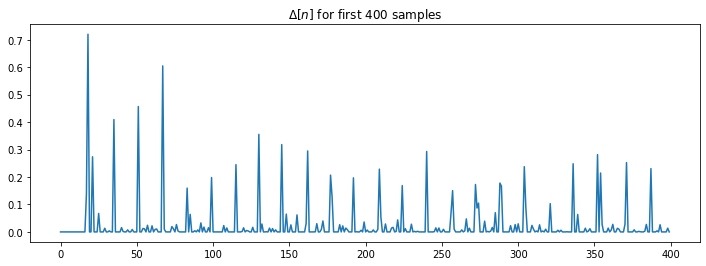

In [26]:
win_len = 1024
hop_size = win_len // 2
nov = fmp.spectral_novelty(snd, win_len, hop_size, 100)
plt.plot(nov[0:400])
plt.title("$\Delta[n]$ for first 400 samples");

Note that for this choice of parameters, the feature rate of $\Delta^s[n]$ is $F_f = {F_s \over H}$.

In [27]:
ff = fs / float(hop_size) # feature rate of novelty curve
print(f'feature rate = {ff:.2f} Hz. Period = {1000/ff:.2f} ms')

feature rate = 43.07 Hz. Period = 23.22 ms


Now, compute the STFT of $\Delta^s[n]$ using these parameters:

$N_{tg} = 256$  
$H_{tg} = 8$

This DFT window length $N_{tg}$ is:

In [28]:
win_len_tg = 256
hop_tg = 8

print(f'window len = {win_len_tg / ff:.2f} seconds')

window len = 5.94 seconds


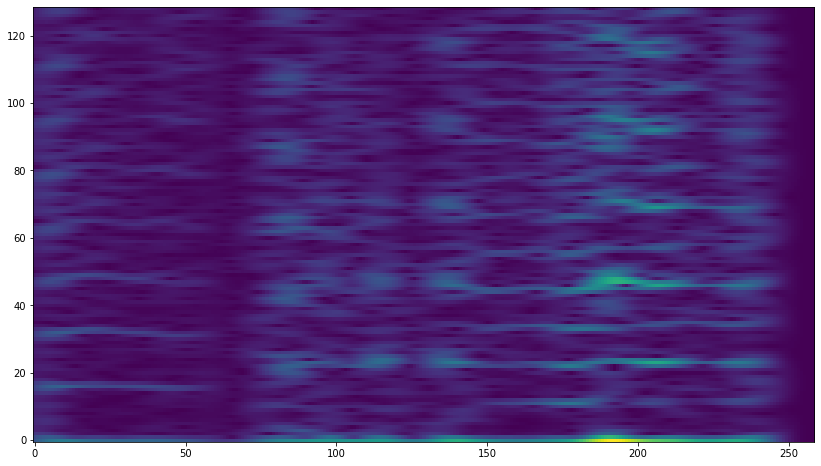

In [29]:
tg = fmp.stft(nov, win_len_tg, hop_tg)

plt.rcParams['figure.figsize'] = (14, 8)
plt.imshow(abs(tg), origin='lower', aspect='auto');

This is the tempogram indexed by $[n,k]$. How do we interpret this?

On the time-axis the feature rate is: 
$$F_{tg} = {F_f \over H_{tg}}\text{Hz}$$

Or, the sampling period is 
$$T_{tg} = {H_{tg} \over F_f }\text{seconds}$$


In [30]:
f_tg = ff / hop_tg
print(f'feature rate = {f_tg:.2f} Hz or sampling period = {1/f_tg:.2f} seconds')

feature rate = 5.38 Hz or sampling period = 0.19 seconds


So the time (in seconds) at each horizontal index value is:

$$t = n \cdot {H_{tg} \over F_f }\text{seconds}$$

One the frequency axis, the _frequency resolution_ is:
$$ {F_f \over N_{tg}} $$

In [31]:
freq_res_tg = ff / win_len_tg
print(f'frequency resolution = {freq_res_tg:.3f} Hz')

frequency resolution = 0.168 Hz


So each bin ($k$) corresponds to the frequency:
$$ f_k = k \cdot {F_f \over N_{tg} }$$

The units of $f$ are cycles (beats) per second. Therefore to get BPM (beats per minute):

$$ \tau_k = k \cdot 60 \cdot {F_f \over N_{tg} }$$

In [32]:
tg_bpms = 60 * np.arange(tg.shape[0]) * freq_res_tg

print('bpms:')
for k in range(20):
    print(f'k={k} bpm={tg_bpms[k]:.2f}')

bpms:
k=0 bpm=0.00
k=1 bpm=10.09
k=2 bpm=20.19
k=3 bpm=30.28
k=4 bpm=40.37
k=5 bpm=50.47
k=6 bpm=60.56
k=7 bpm=70.66
k=8 bpm=80.75
k=9 bpm=90.84
k=10 bpm=100.94
k=11 bpm=111.03
k=12 bpm=121.12
k=13 bpm=131.22
k=14 bpm=141.31
k=15 bpm=151.41
k=16 bpm=161.50
k=17 bpm=171.59
k=18 bpm=181.69
k=19 bpm=191.78


Let's have a closer look at the columns of the tempogram:

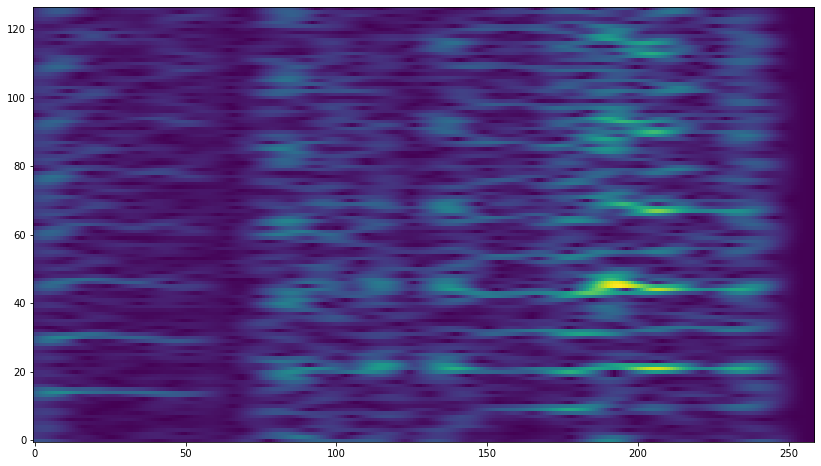

In [33]:
plt.imshow(abs(tg[2:,:]), origin='lower', aspect='auto');

Here we are looking at one column at a time.

In [34]:
@interact(n=fmp.slider(0,tg.shape[1]-1), _bpm=False)
def tg_scan(n = 0, _bpm = False):
    plt.figure(figsize=(12, 4))
    if _bpm:
        plt.plot(tg_bpms, abs(tg[:,n]))
        plt.xlabel('BPM')        
    else:
        plt.plot(abs(tg[:,n]))
        plt.xlabel('k')
    plt.show()

interactive(children=(IntSlider(value=0, continuous_update=False, description='n', max=258), Checkbox(value=Fa…

This gives us a pretty good view of the general tempo characteristics of the song. But, we want something more accurate. We only have a resolution of about 10 BPM.

Let's use the zero-padding trick to get a finer sampling resolution of the frequency domain for the Fourier Transform:

Currently, the FT window is length $N_{tg}=256$. Let's zero-pad by a factor of $Z_{tg} = 16$, giving a BPM resolution of:

$$ 60 \cdot {F_f \over N_{tg} \cdot Z_{tg} }$$


In [35]:
win_len_tg = 256
hop_tg = 8
zp_tg = 16
freq_res_tg = ff / (win_len_tg * zp_tg)
print(f'enhanced frequency resolution = {60 * freq_res_tg:.2f} BPM')

enhanced frequency resolution = 0.63 BPM


Here are the BPM values with the enahanced tempo resolution

In [36]:
tg_bpms = 60 * np.arange(win_len_tg * zp_tg //2 + 1) * freq_res_tg
print(tg_bpms.shape)
for k in range(0,20):
    print(f'k={k} bpm={tg_bpms[k]:.2f}')
print('...')
for k in range(300, 320):
    print(f'k={k} bpm={tg_bpms[k]:.2f}')


(2049,)
k=0 bpm=0.00
k=1 bpm=0.63
k=2 bpm=1.26
k=3 bpm=1.89
k=4 bpm=2.52
k=5 bpm=3.15
k=6 bpm=3.79
k=7 bpm=4.42
k=8 bpm=5.05
k=9 bpm=5.68
k=10 bpm=6.31
k=11 bpm=6.94
k=12 bpm=7.57
k=13 bpm=8.20
k=14 bpm=8.83
k=15 bpm=9.46
k=16 bpm=10.09
k=17 bpm=10.72
k=18 bpm=11.36
k=19 bpm=11.99
...
k=300 bpm=189.26
k=301 bpm=189.89
k=302 bpm=190.52
k=303 bpm=191.15
k=304 bpm=191.78
k=305 bpm=192.41
k=306 bpm=193.04
k=307 bpm=193.67
k=308 bpm=194.30
k=309 bpm=194.93
k=310 bpm=195.57
k=311 bpm=196.20
k=312 bpm=196.83
k=313 bpm=197.46
k=314 bpm=198.09
k=315 bpm=198.72
k=316 bpm=199.35
k=317 bpm=199.98
k=318 bpm=200.61
k=319 bpm=201.24


Joana: this resolution of 10bpm is too coarse, however. What we can do is to zero-pad to make it finer -> more bins. Zero-padding is a multiplying factor, so the new formula for frequency resolution

Finally, the enhanced tempogram. The function `fmp.stft()` has an optional argument that allows for a zero-padding factor.

Note the number of bins (ie, # of rows) is much higher.

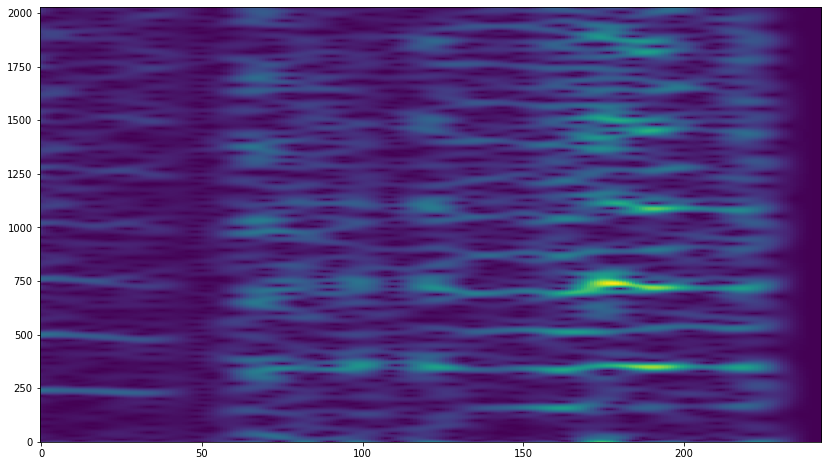

In [37]:
tg = fmp.stft(nov, win_len_tg, hop_tg, zp_tg, centered=False)
plt.imshow(abs(tg[20:,:]), origin='lower', aspect='auto');

Listen to the implied tempo

BPMs at peaks are: [160.86816788 321.73633575 482.60450363 644.73438263 806.86426163
 968.36328506]


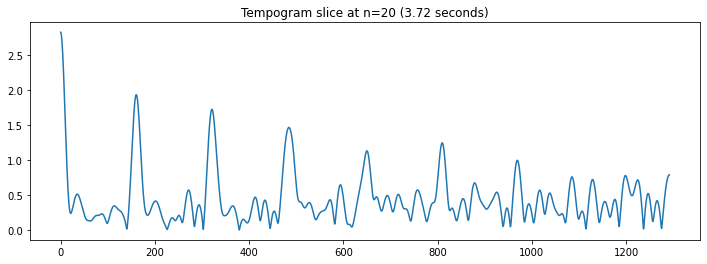

In [38]:
plt.rcParams['figure.figsize'] = (12, 4)

location = 20
# location = 165

peak_bpms = tg_bpms[fmp.find_peaks(tg[:,location], 0.5)]
plt.plot(tg_bpms, abs(tg[:,location]))
plt.title(f'Tempogram slice at n={location} ({location / f_tg:.2f} seconds)')
print(f'BPMs at peaks are: {peak_bpms}')

In [39]:
click_snd = fmp.load_wav("audio/click.wav")

@interact(peak=(0,3))
def test_beats(peak=0):
    print('BPM:', peak_bpms[peak])
    beats = np.arange(10) * int(60 * fs  / peak_bpms[peak])
    clicks = fmp.make_clicks(beats, click_snd = click_snd)
    return ipd.Audio(clicks, rate=fs)

interactive(children=(IntSlider(value=0, description='peak', max=3), Output()), _dom_classes=('widget-interact…

In [40]:
ipd.Audio(snd, rate = fs)

### Autocorrelation Tempogram

Another approach to create a tempogram is to use autocorrelation.

As before, this is the novelty function: $\Delta^s[n]$

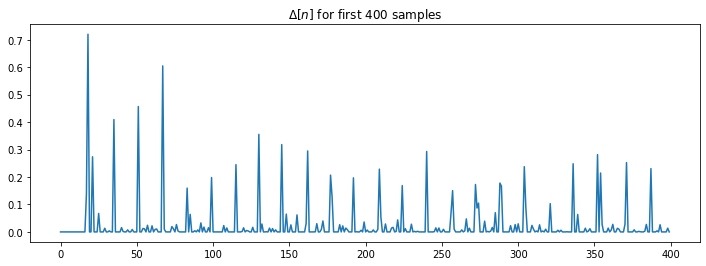

In [41]:
snd = fmp.load_wav("audio/beatles_i_want_you.wav", 0, 45)
fs = 22050
win_len = 1024
hop_size = win_len // 2
nov = fmp.spectral_novelty(snd, win_len, hop_size, 100)
ff = fs / float(hop_size) # feature rate of novelty curve

plt.plot(nov[0:400])
plt.title("$\Delta[n]$ for first 400 samples");

In autocorrelation, we take a window of a signal and shift it against itself, taking the dot product at each step.

The step number is also know as the _lag_.

For example, start with a window of $L=100$

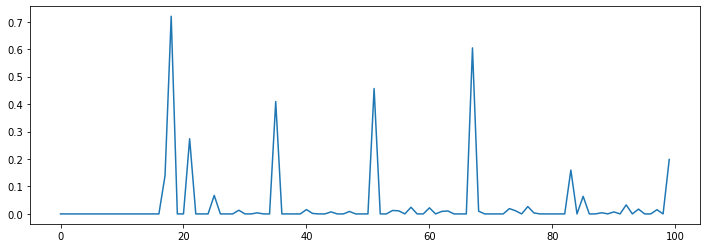

In [42]:
wx = nov[0:100]
plt.plot(wx);

Now, for this window of data $x[n]$, perform shifted dot products:

$$ R_{xx}[l] = \sum_{n=0}^{L-1} x[n] x[n-l] $$


In [43]:
@interact(lag=(0, 99))
def test_ac(lag = 0) :
    L = len(wx)
    a = wx
    b = np.concatenate((np.zeros(lag), wx[0:L-lag]))
    dp = a.dot(b)
    plt.plot(a)
    plt.plot(b, 'r')
    txt = f'$R_{{xx}}[{lag}] = {dp:.2f}$'
    plt.title(txt, fontsize=20)
    plt.show()

interactive(children=(IntSlider(value=0, description='lag', max=99), Output()), _dom_classes=('widget-interact…

The function `auto_correlate()` below generates the autocorrelation based on the numpy function `np.correlate`

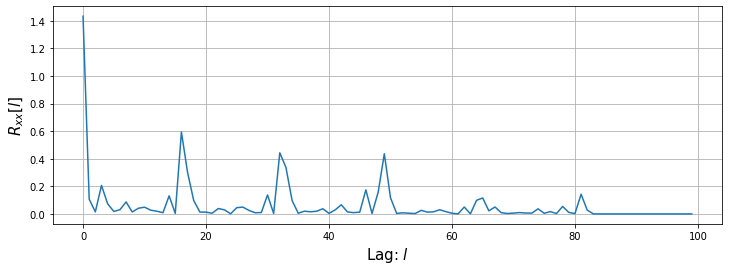

In [44]:
def auto_correlate(x):
    ac = np.correlate(x, x, mode='full')
    return ac[len(x)-1:]

ac = auto_correlate(wx);
plt.plot(ac)
plt.grid()
plt.xlabel('Lag: $l$', fontsize=15)
plt.ylabel('$R_{xx}[l]$', fontsize=15);

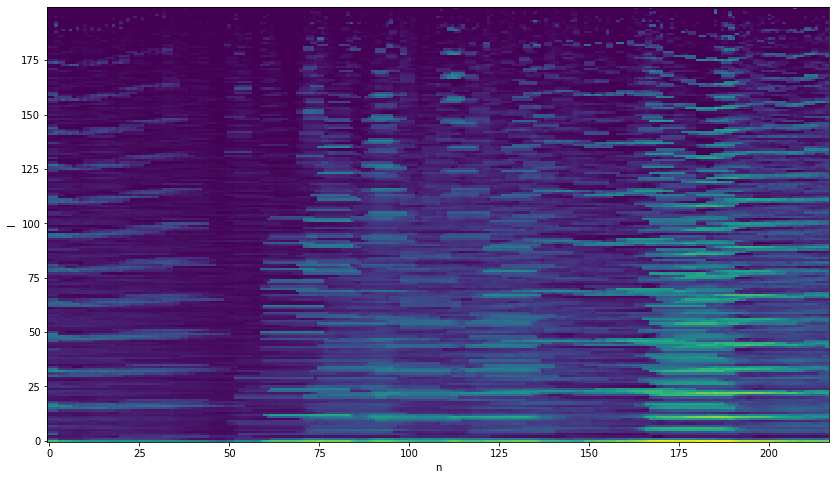

In [45]:
win_len_tg = 200
hop_tg = 8

tg = fmp.make_ac_tempogram(nov, win_len_tg, hop_tg)

plt.figure(figsize=(14,8))
plt.imshow(np.log10(1 + 10*tg), origin='lower', aspect='auto');
plt.xlabel('n')
plt.ylabel('l');

<font color='red'>__Whiteboard__</font>: AC tempogram

This is the autocorrelation tempogram: $\mathcal{A}[n,l]$

- $n$ is "time" - horizontal
- $l$ is "lag" - vertical.


The time-axis is the same as the Fourier tempogram: 
$$t = n { H_{tg} \over F_f } $$

But on the vertical axis, each bin ($l$) corresponds to a lag value. This is _time_, not _frequency_. The periodicity of each bin (in seconds) is:
$$ T_l = {l \over F_f} $$

In [46]:
periods = np.arange(win_len_tg) / ff
print('periods (in seconds) =')

for l in range(0,20):
    print(f'l={l} period={periods[l]:.2f}')
print('...')
for l in range(180, 200):
    print(f'l={l} period={periods[l]:.2f}')

periods (in seconds) =
l=0 period=0.00
l=1 period=0.02
l=2 period=0.05
l=3 period=0.07
l=4 period=0.09
l=5 period=0.12
l=6 period=0.14
l=7 period=0.16
l=8 period=0.19
l=9 period=0.21
l=10 period=0.23
l=11 period=0.26
l=12 period=0.28
l=13 period=0.30
l=14 period=0.33
l=15 period=0.35
l=16 period=0.37
l=17 period=0.39
l=18 period=0.42
l=19 period=0.44
...
l=180 period=4.18
l=181 period=4.20
l=182 period=4.23
l=183 period=4.25
l=184 period=4.27
l=185 period=4.30
l=186 period=4.32
l=187 period=4.34
l=188 period=4.37
l=189 period=4.39
l=190 period=4.41
l=191 period=4.44
l=192 period=4.46
l=193 period=4.48
l=194 period=4.50
l=195 period=4.53
l=196 period=4.55
l=197 period=4.57
l=198 period=4.60
l=199 period=4.62


The frequency at each bin (beats per second) is the inverse:
$$ f_l = {F_f \over l }$$

And the tempo as BPM (beats per minute) at each bin $l$ is:

$$ \tau_l =  60 \cdot {F_f \over l } $$

In [47]:
tg_bpms = 60 * ff / np.arange(win_len_tg)
print('BPMs:')
for l in range(0,20):
    print(f'l={l} period={tg_bpms[l]:.2f}')
print('...')
for l in range(180, 200):
    print(f'l={l} period={tg_bpms[l]:.2f}')

BPMs:
l=0 period=inf
l=1 period=2583.98
l=2 period=1291.99
l=3 period=861.33
l=4 period=646.00
l=5 period=516.80
l=6 period=430.66
l=7 period=369.14
l=8 period=323.00
l=9 period=287.11
l=10 period=258.40
l=11 period=234.91
l=12 period=215.33
l=13 period=198.77
l=14 period=184.57
l=15 period=172.27
l=16 period=161.50
l=17 period=152.00
l=18 period=143.55
l=19 period=136.00
...
l=180 period=14.36
l=181 period=14.28
l=182 period=14.20
l=183 period=14.12
l=184 period=14.04
l=185 period=13.97
l=186 period=13.89
l=187 period=13.82
l=188 period=13.74
l=189 period=13.67
l=190 period=13.60
l=191 period=13.53
l=192 period=13.46
l=193 period=13.39
l=194 period=13.32
l=195 period=13.25
l=196 period=13.18
l=197 period=13.12
l=198 period=13.05
l=199 period=12.98


<ipython-input-47-c444bbadd6b2>:1: RuntimeWarning: divide by zero encountered in true_divide
  tg_bpms = 60 * ff / np.arange(win_len_tg)


This tempogram has a non-uniform frequency resolution. The frequency resolution gets better as the tempo values get slower.

In [48]:
@interact(n=fmp.slider(0,200), _bpm=False)
def tg_plot(n=0, _bpm=False):
    if _bpm:
        plt.plot(tg_bpms, tg[:, n])
        plt.xlim(20, 200)
        plt.xlabel('BPM')
    else:
        plt.plot(tg[:, n])
        plt.xlabel('Lag')
    plt.ylim(0, 1)
    plt.show()

interactive(children=(IntSlider(value=0, continuous_update=False, description='n', max=200), Checkbox(value=Fa…

Listen to the implied tempo:

[161.49902344  80.74951172  53.83300781  40.37475586  32.29980469
  27.19983553  23.07128906]


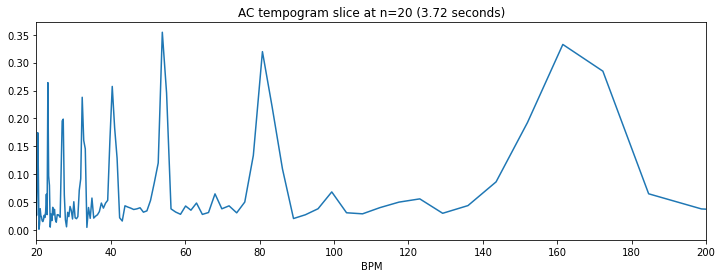

In [49]:
location = 20
# location = 165
plt.plot(tg_bpms, tg[:, location])
plt.xlim(20, 200)
plt.xlabel('BPM')
plt.title(f'AC tempogram slice at n={location} ({location / f_tg:.2f} seconds)')

peak_bpms = tg_bpms[fmp.find_peaks(tg[:,location], 0.5)]
print(peak_bpms)

In [50]:
@interact(peak=(0,3))
def test_beats(peak=0):
    print('BPM:', peak_bpms[peak])
    beats = np.arange(10) * int(60 * fs  / peak_bpms[peak])
    clicks = fmp.make_clicks(beats, click_snd = click_snd)
    return ipd.Audio(clicks, rate=fs)

interactive(children=(IntSlider(value=0, description='peak', max=3), Output()), _dom_classes=('widget-interact…

In [51]:
ipd.Audio(snd, rate = fs)

Both tempograms are interesting and highlight different rhythmic attributes of the song:

- Fourier tempogram: highlights tempo harmonics (subdivisions of the beat)
- Autocorrelation tempogram: highlights tempo subharmonics (groupings of beats)

### Predominant Local Pulse

We can use the information in a tempogram to reconstruct the predominant pulses of some audio. The Fourier tempogram is particularly useful because it also contains phase information.

The idea is to find the peak (maximum value) of the tempogram at each time step.

This is our Fourier tempogram again, but this time with a larger hop size:  
$N_{tg} = 256$  
$H_{tg} = 64$  
$Z_{tg} = 16$  


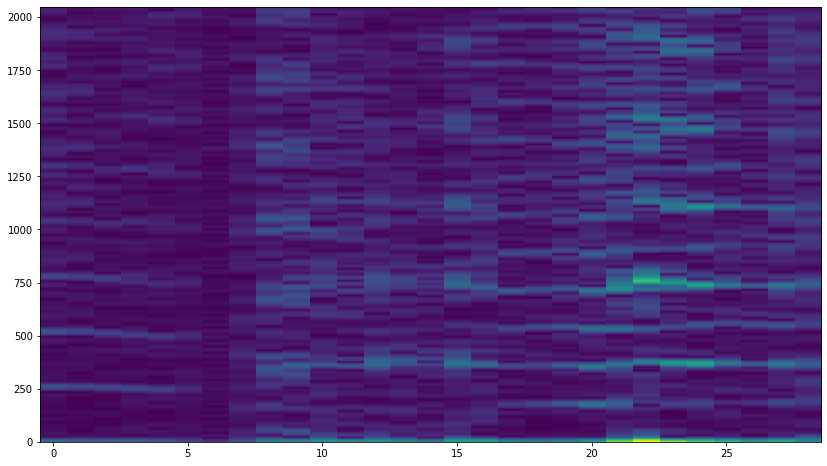

In [52]:
win_len_tg = 256
hop_tg = 64
zp_tg = 16

tg = fmp.stft(nov, win_len_tg, hop_tg, zp_tg, centered=False)[:,:-2]
plt.figure(figsize=(14,8))
plt.imshow(abs(tg), origin='lower', aspect='auto');

Now, for each column, pick the maximum value to be the "most likely tempo" at that moment.

It is helpful to place limitations on the tempogram, so we don't bother with tempos that are too high or too low.

In [53]:
@interact(p = fmp.slider(0,tg.shape[1]-1), limit = False)
def tg_scan(p = 0, limit = False):
    f_tg = ff / (win_len_tg * zp_tg)
    tempo = np.abs(tg[:,p])
    col_max = np.max(tempo)
    
    if limit:
        bpm_min, bpm_max = 40, 300
        plt.title(f'Limit tempo to BPM range: {bpm_min} - {bpm_max}')
        plt.vlines((bpm_min, bpm_max), 0, col_max, 'r')
    else:
        bpm_min, bpm_max = 0, 100000
        plt.title('Highest Peak of Tempo Curve')

    k = fmp.best_tempogram_bins(tg, ff, bpm_min, bpm_max)[p]
    bpms = np.arange(len(tempo)) * 60 * f_tg
    plt.plot(bpms, tempo)
    plt.plot(bpms[k], tempo[k], 'ro')
    plt.ylim(0, col_max)
    plt.show()

interactive(children=(IntSlider(value=0, continuous_update=False, description='p', max=28), Checkbox(value=Fal…

Now, we apply this method (BPM-limited maxima) to capture the most likely tempo (tempogram bin) at each time step.

Here, as above, we constrain the tempogram to the BPM range of 40-300 BPM.

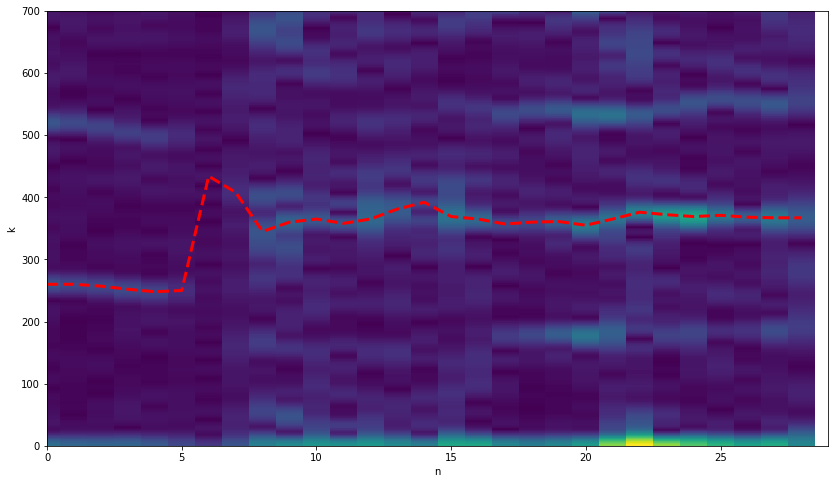

In [54]:
bins = fmp.best_tempogram_bins(tg, ff, 40, 300)
    
plt.figure(figsize=(14,8))
plt.imshow(abs(tg), origin='lower', aspect='auto')
plt.plot(np.arange(len(bins)), bins, 'r--', linewidth=3)
plt.xlim(0, tg.shape[1])
plt.ylim(0, 700)
plt.xlabel('n')
plt.ylabel('k');

The next step is to pick out the sinusoidal parameters from the tempogram. Since the tempogram is really a spectrogram $\mathcal{F}[n,k]$, each point at $[n,k]$ is a complex number with a magnitude and a phase.

We can recreate the sinusoid associated with that point as follows:

With $c = \mathcal{F}[n,k]$:  
- $A = {2 \over N}  \lvert c \lvert $  
- $f = k \cdot {F_s \over N}$  
- $\phi = \angle(c)$  

The sinusoid contributing to that part of the signal is:
$x[n] = A \cos(2 \pi f n / F_s + \phi)$


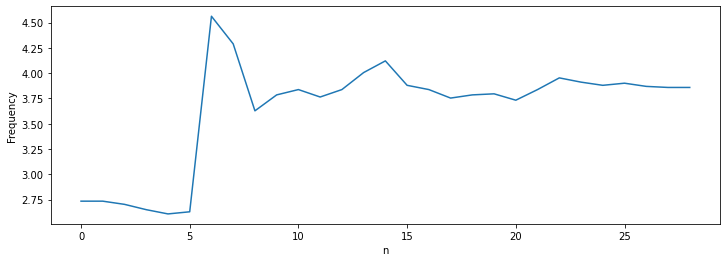

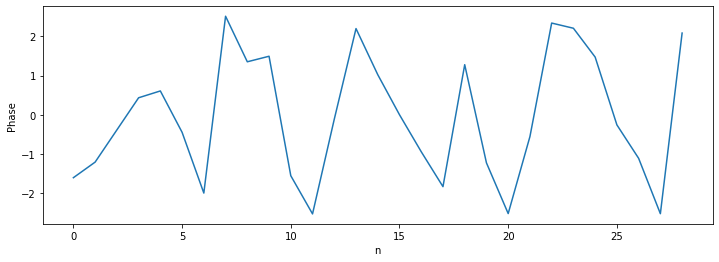

In [55]:
freqs, phases = fmp.get_sinusoid_params(tg, ff, bins)

plt.figure()
plt.plot(freqs)
plt.ylabel('Frequency')
plt.xlabel('n')
plt.figure()
plt.plot(phases)
plt.ylabel('Phase')
plt.xlabel('n');

A more useful way of viewing these frequencies and phases is to create sinusoids - which will form a "synthetic pulse train". 

We ignore the amplitude of the sinusoid, and make them all uniform height.

It is also useful to window this pulse train with a Hann window.

In [56]:
@interact(h=(0,15), win=False)
def local_pulse_demo(h=0, win=False):
    start = h * hop_tg
    print(f'at h={h}: bin={bins[h]}, freq={freqs[h]}, phase={phases[h]}')

    n = np.arange(win_len_tg)
    est = np.cos(2 * np.pi * freqs[h] * n / ff + phases[h])
    if win:
        est *= np.hanning(win_len_tg)
    est = np.concatenate((np.zeros(start), est))

    plt.figure()
    plt.title('Novelty Curve $\Delta[n]$ with synthesized pulse');
    plt.plot(nov * 3)
    plt.plot(est, 'r')
    plt.xlim(0,1000)
    plt.ylim(-1.5, 3)
    plt.show()

interactive(children=(IntSlider(value=0, description='h', max=15), Checkbox(value=False, description='win'), O…

Now, combine all these windowed sinusoid pulses together:

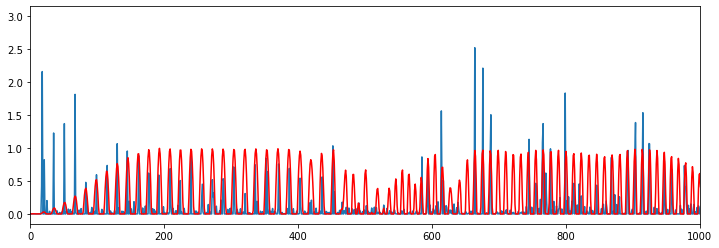

In [57]:
plp = fmp.make_local_pulse(nov, ff, 40, 300, win_len_tg=win_len_tg, hop_tg=hop_tg)
plt.plot(nov * 3)
plt.plot(plp, 'r')
plt.xlim(0,1000);

In [58]:
peaks = fmp.find_peaks(plp, thresh = 0)
beats = (peaks * (fs/ff)).astype(np.int)
clicks = fmp.make_clicks(beats, len(snd), fmp.load_wav('audio/click.wav'))
ipd.Audio([snd*.5, clicks],rate=fs)

<ipython-input-58-54528e38ffc0>:2: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  beats = (peaks * (fs/ff)).astype(np.int)


Careful with time units!

- original sampling rate
- novelty function sampling rate
- tempogram sampling rate


<ipython-input-59-6115344ffe55>:33: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  beats = (peaks * (fs/ff)).astype(np.int)


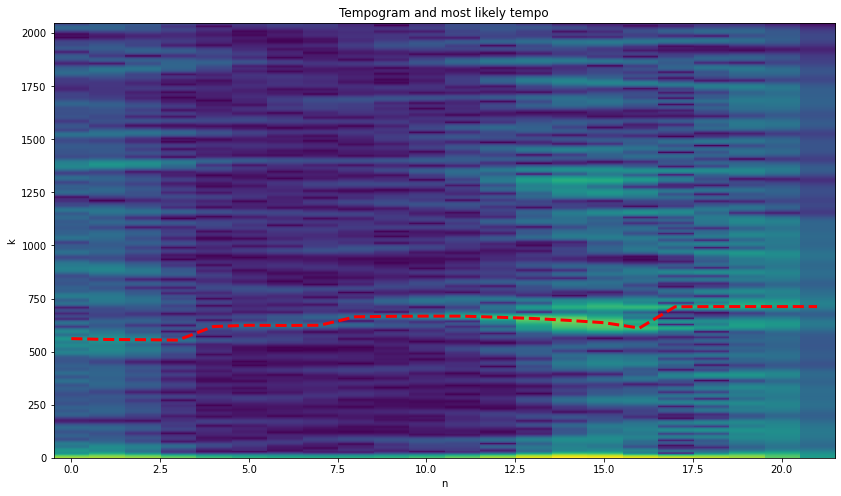

In [59]:
def plp_demo(sndfile):
    bpm_min = 30
    bpm_max = 450

    snd = fmp.load_wav(sndfile)

    # create novelty function
    fs = 22050
    win_len = 1024
    hop_size = win_len // 2
    nov = fmp.spectral_novelty(snd, win_len, hop_size, 100)
    ff = float(fs)/hop_size

    # create fourier tempogram
    win_len_tg = 256
    hop_tg = 32
    zp_tg = 16
    tg = abs(fmp.stft(nov, win_len_tg, hop_tg, zp_tg, centered=False))[:,:-2]

    # find most likely tempo at each location
    bins = fmp.best_tempogram_bins(tg, ff, bpm_min, bpm_max)

    plt.figure(figsize=(14,8))
    plt.imshow(np.log10(1 + tg), origin='lower', aspect='auto')
    plt.plot(np.arange(len(bins)), bins, 'r--', linewidth=3)
    plt.xlabel('n')
    plt.ylabel('k')
    plt.title('Tempogram and most likely tempo')

    # construct PLP, and play
    plp = fmp.make_local_pulse(nov, ff, bpm_min, bpm_max, win_len_tg, hop_tg, zp_tg)
    peaks = fmp.find_peaks(plp, thresh = 0)
    beats = (peaks * (fs/ff)).astype(np.int)
    clicks = fmp.make_clicks(beats, len(snd), fmp.load_wav('audio/click.wav'))
    return ipd.Audio([snd, clicks * .5],rate=fs)

plp_demo("audio/beeth5_orch_21bars.wav")